In [ ]:
#library imports
import os
import random
import math
from datetime import datetime
from collections import Counter
import pandas as pd
import numpy as np

import cv2
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from sklearn.model_selection import train_test_split
import xml.etree.ElementTree as ET

import torch
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models

from google.colab.patches import cv2_imshow
from torchvision.models import resnet50

import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


References: </br>
https://towardsdatascience.com/bounding-box-prediction-from-scratch-using-pytorch-a8525da51ddc

In [ ]:
# !unzip '/content/drive/MyDrive/FireDetectionProject2022/FinalDataset.v2-final_dataset_yolo.voc.zip' -d '/content/drive/MyDrive/FireDetectionProject2022/FinalDataset'


In [ ]:
def filelist(root, file_type):
    """Returns a fully-qualified list of filenames under root directory"""
    return [os.path.join(directory_path, f) for directory_path, directory_name, 
            files in os.walk(root) for f in files if f.endswith(file_type)]

def generate_train_df (anno_path, images_path):
    annotations = filelist(anno_path, '.xml')
    anno_list = []
    for anno_path in annotations:
        root = ET.parse(anno_path).getroot()
        anno = {}
        anno['filename'] = Path(str(images_path) + '/'+ root.find("./filename").text)
        anno['width'] = root.find("./size/width").text
        anno['height'] = root.find("./size/height").text
        if(root.find("./object")):
          anno['class'] = root.find("./object/name").text
          anno['xmin'] = int(root.find("./object/bndbox/xmin").text)
          anno['ymin'] = int(root.find("./object/bndbox/ymin").text)
          anno['xmax'] = int(root.find("./object/bndbox/xmax").text)
          anno['ymax'] = int(root.find("./object/bndbox/ymax").text)
        else:
          anno['class'] = 'none'
          anno['xmin'] = None
          anno['ymin'] = None
          anno['xmax'] = None
          anno['ymax'] = None
        
        anno_list.append(anno)
    return pd.DataFrame(anno_list)

In [ ]:
train_path = Path('/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/train')
df_train = generate_train_df('/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/train',train_path)
val_path = Path('/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/valid')
df_valid = generate_train_df('/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/valid', val_path)

In [ ]:
#label encode target
class_dict = {'none': 0, 'smoke': 1}
df_train['class'] = df_train['class'].apply(lambda x:  class_dict[x])
df_valid['class'] = df_valid['class'].apply(lambda x:  class_dict[x])

In [ ]:
print(df_train.shape, df_valid.shape)
df_train.head()
df_valid.head()

Resizing images and bounding boxes

In [ ]:
def read_image(path):
    return cv2.cvtColor(cv2.imread(str(path)), cv2.COLOR_BGR2RGB)

In [ ]:
def create_mask(bb, x):
    """Creates a mask for the bounding box of same shape as image"""
    rows,cols,*_ = x.shape
    Y = np.zeros((rows, cols))
    bb = bb.astype(np.int)
    Y[bb[0]:bb[2], bb[1]:bb[3]] = 1.
    return Y
    
def mask_to_bb(Y):
    """Convert mask Y to a bounding box, assumes 0 as background nonzero object"""
    cols, rows = np.nonzero(Y)
    if len(cols)==0: 
        return np.zeros(4, dtype=np.float32)
    top_row = np.min(rows)
    left_col = np.min(cols)
    bottom_row = np.max(rows)
    right_col = np.max(cols)
    return np.array([left_col, top_row, right_col, bottom_row], dtype=np.float32)

def create_bb_array(x):
    """Generates bounding box array from a train_df row"""
    return np.array([x[5],x[4],x[7],x[6]])

In [ ]:
def resize_image_bb(read_path,write_path,bb,sz):
    """Resize an image and its bounding box and write image to new path"""
    im = read_image(read_path)
    im_resized = cv2.resize(im, (int(1.49*sz), sz))
    Y_resized = cv2.resize(create_mask(bb, im), (int(1.49*sz), sz))
    new_path = str(write_path/read_path.parts[-1])
    cv2.imwrite(new_path, cv2.cvtColor(im_resized, cv2.COLOR_RGB2BGR))
    return new_path, mask_to_bb(Y_resized)

In [ ]:
def resize_image_bb_2(read_path,write_path,bb,sz):
    """Resize an image and its bounding box and write image to new path"""
    im = read_image(read_path)
    # im_resized = cv2.resize(im, (int(1.49*sz), sz))
    Y_resized = cv2.resize(create_mask(bb, im), (int(1.49*sz), sz))
    new_path = str(write_path/read_path.parts[-1])
    # cv2.imwrite(new_path, cv2.cvtColor(im_resized, cv2.COLOR_RGB2BGR))
    return new_path, mask_to_bb(Y_resized)

In [ ]:
#Populating Training DF with new paths and bounding boxes
new_paths = []
new_bbs = []
train_path_resized = Path('/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/train_resized')
for index, row in df_train.iterrows():
    new_path,new_bb = resize_image_bb_2(row['filename'], train_path_resized, create_bb_array(row.values),300)
    new_paths.append(new_path)
    new_bbs.append(new_bb)
df_train['new_path'] = new_paths
df_train['new_bb'] = new_bbs

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """


In [ ]:
#Populating Training DF with new paths and bounding boxes
new_paths = []
new_bbs = []
valid_path_resized = Path('/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/valid_resized')
for index, row in df_valid.iterrows():
    new_path,new_bb = resize_image_bb_2(row['filename'], valid_path_resized, create_bb_array(row.values),300)
    new_paths.append(new_path)
    new_bbs.append(new_bb)
df_valid['new_path'] = new_paths
df_valid['new_bb'] = new_bbs

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """


Train-Test Data

In [ ]:
df_train = df_train.reset_index()
df_valid = df_valid.reset_index()

In [ ]:
X_train = df_train[['new_path', 'new_bb']]
Y_train = df_train['class']
X_valid = df_valid[['new_path', 'new_bb']]
Y_valid = df_valid['class']

In [ ]:
print(df_train.shape, df_valid.shape)
df_train.head()
# df_valid.head()

(910, 11) (144, 11)


,index,filename,width,height,class,xmin,ymin,xmax,ymax,new_path,new_bb
0,0,/content/drive/MyDrive/FireDetectionProject202...,416,416,0,NaN,NaN,NaN,NaN,/content/drive/MyDrive/FireDetectionProject202...,"[0.0, 0.0, 0.0, 0.0]"
1,1,/content/drive/MyDrive/FireDetectionProject202...,416,416,0,NaN,NaN,NaN,NaN,/content/drive/MyDrive/FireDetectionProject202...,"[0.0, 0.0, 0.0, 0.0]"
2,2,/content/drive/MyDrive/FireDetectionProject202...,416,416,1,315.0,179.0,336.0,198.0,/content/drive/MyDrive/FireDetectionProject202...,"[129.0, 338.0, 142.0, 361.0]"
3,3,/content/drive/MyDrive/FireDetectionProject202...,416,416,0,NaN,NaN,NaN,NaN,/content/drive/MyDrive/FireDetectionProject202...,"[0.0, 0.0, 0.0, 0.0]"
4,4,/content/drive/MyDrive/FireDetectionProject202...,416,416,0,NaN,NaN,NaN,NaN,/content/drive/MyDrive/FireDetectionProject202...,"[0.0, 0.0, 0.0, 0.0]"


Annotations

In [ ]:
def create_corner_rect(bb, color='red'):
    bb = np.array(bb, dtype=np.float32)
    return plt.Rectangle((bb[1], bb[0]), bb[3]-bb[1], bb[2]-bb[0], color=color,
                         fill=False, lw=3)

def show_corner_bb(im, bb):
    plt.figure()
    plt.imshow(im)
    plt.gca().add_patch(create_corner_rect(bb))

/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/train_resized/ck0qbn4c2to820848neklprj5_jpeg_jpg.rf.25d406f801952ccafb4d47c48458717f.jpg


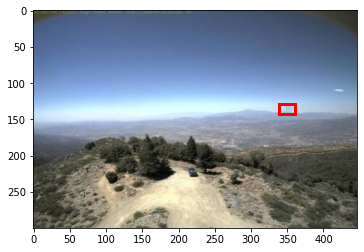

In [ ]:
#Testing original
print(df_train.values[2][9])
im = cv2.imread(str(df_train.values[2][9]))
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
show_corner_bb(im, df_train.values[2][10])

In [ ]:
def normalize(im):
    """Normalizes images with Imagenet stats."""
    imagenet_stats = np.array([[0.485, 0.456, 0.406], [0.229, 0.224, 0.225]])
    return (im - imagenet_stats[0])/imagenet_stats[1]

In [ ]:
# modified from fast.ai
def crop(im, r, c, target_r, target_c): 
    return im[r:r+target_r, c:c+target_c]

# random crop to the original size
def random_crop(x, r_pix=8):
    """ Returns a random crop"""
    r, c,*_ = x.shape
    c_pix = round(r_pix*c/r)
    rand_r = random.uniform(0, 1)
    rand_c = random.uniform(0, 1)
    start_r = np.floor(2*rand_r*r_pix).astype(int)
    start_c = np.floor(2*rand_c*c_pix).astype(int)
    return crop(x, start_r, start_c, r-2*r_pix, c-2*c_pix)

def center_crop(x, r_pix=8):
    r, c,*_ = x.shape
    c_pix = round(r_pix*c/r)
    return crop(x, r_pix, c_pix, r-2*r_pix, c-2*c_pix)

In [ ]:
def rotate_cv(im, deg, y=False, mode=cv2.BORDER_REFLECT, interpolation=cv2.INTER_AREA):
    """ Rotates an image by deg degrees"""
    r,c,*_ = im.shape
    M = cv2.getRotationMatrix2D((c/2,r/2),deg,1)
    if y:
        return cv2.warpAffine(im, M,(c,r), borderMode=cv2.BORDER_CONSTANT)
    return cv2.warpAffine(im,M,(c,r), borderMode=mode, flags=cv2.WARP_FILL_OUTLIERS+interpolation)

def random_cropXY(x, Y, r_pix=8):
    """ Returns a random crop"""
    r, c,*_ = x.shape
    c_pix = round(r_pix*c/r)
    rand_r = random.uniform(0, 1)
    rand_c = random.uniform(0, 1)
    start_r = np.floor(2*rand_r*r_pix).astype(int)
    start_c = np.floor(2*rand_c*c_pix).astype(int)
    xx = crop(x, start_r, start_c, r-2*r_pix, c-2*c_pix)
    YY = crop(Y, start_r, start_c, r-2*r_pix, c-2*c_pix)
    return xx, YY
    
def transformsXY(path, bb, transforms):
    x = cv2.imread(str(path)).astype(np.float32)
    x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)/255
    Y = create_mask(bb, x)
    if transforms:
        rdeg = (np.random.random()-.50)*20
        x = rotate_cv(x, rdeg)
        Y = rotate_cv(Y, rdeg, y=True)
        if np.random.random() > 0.5: 
            x = np.fliplr(x).copy()
            Y = np.fliplr(Y).copy()
        x, Y = random_cropXY(x, Y)
    else:
        x, Y = center_crop(x), center_crop(Y)
    return x, mask_to_bb(Y)

In [ ]:
class SmokeDataset(Dataset):
    def __init__(self, paths, bb, y, transforms=False):
        self.transforms = transforms
        self.paths = paths.values
        self.bb = bb.values
        self.y = y.values
    def __len__(self):
        return len(self.paths)
    
    def __getitem__(self, idx):
        path = self.paths[idx]
        y_class = self.y[idx]
        x, y_bb = transformsXY(path, self.bb[idx], self.transforms)
        x = normalize(x)
        x = np.rollaxis(x, 2)
        return x, y_class, y_bb

In [ ]:
train_ds = SmokeDataset(X_train['new_path'],X_train['new_bb'] ,Y_train, transforms=True)
valid_ds = SmokeDataset(X_valid['new_path'],X_valid['new_bb'],Y_valid)

In [ ]:
batch_size = 1
train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
valid_dl = DataLoader(valid_ds, batch_size=batch_size)

Model

In [ ]:
# class BB_model(nn.Module):
#     def __init__(self):
#         super(BB_model, self).__init__()
#         resnet = models.resnet34(pretrained=True)
#         layers = list(resnet.children())[:8]
#         self.features1 = nn.Sequential(*layers[:6])
#         self.features2 = nn.Sequential(*layers[6:])
#         self.classifier = nn.Sequential(nn.BatchNorm1d(512), nn.Linear(512, 4))
#         self.bb = nn.Sequential(nn.BatchNorm1d(512), nn.Linear(512, 4))
        
#     def forward(self, x):
#         x = self.features1(x)
#         x = self.features2(x)
#         x = F.relu(x)
#         x = nn.AdaptiveAvgPool2d((1,1))(x)
#         x = x.view(x.shape[0], -1)
#         return self.classifier(x), self.bb(x)

In [ ]:
# propagate inputs through ResNet-50 up to avg-pool layer
        # print("layer:",inputs.size())
        # x = self.backbone.conv1(inputs)
        # x = self.backbone.bn1(x)
        # x = self.backbone.relu(x)
        # x = self.backbone.maxpool(x)

        # x = self.backbone.layer1(x)
        # x = self.backbone.layer2(x)
        # x = self.backbone.layer3(x)
        # x = self.backbone.layer4(x)

        # # convert from 2048 to 256 feature planes for the transformer
        # h = self.conv(x)
        # # print(h.size()) # torch.Size([4, 64, 9, 14])

        # # construct positional encodings
        # H, W = h.shape[-2:]
        # # print("pos:",(torch.cat([
        # #     self.col_embed[:W].unsqueeze(0).repeat(H, 1, 1),
        # #     self.row_embed[:H].unsqueeze(1).repeat(1, W, 1),
        # # ], dim=-1).flatten(0, 1).unsqueeze(1)).size())
        # # print("pos:",(self.row_embed[:H].unsqueeze(1).repeat(1, W, 1)).size())
        # pos = torch.cat([
        #     self.col_embed[:W].unsqueeze(0).repeat(H, 1, 1),
        #     self.row_embed[:H].unsqueeze(1).repeat(1, W, 1),
        # ], dim=-1).flatten(0, 1).unsqueeze(1)
        # # print(pos.size()) # torch.Size([126, 1, 64])
        # # print((0.1 * h.flatten(2).permute(2, 0, 1)).size()) # torch.Size([126, 4, 64]) 

        # # propagate through the transformer
        # print("src:",(pos +  0.1 * h.flatten(2).permute(2, 0, 1)).size())
        # print("tgt:",(self.query_pos.unsqueeze(1)).size())
        # # src: torch.Size([126, 4, 64])
        # # tgt: torch.Size([126, 1, 64])
        # h = self.transformer(pos +  0.1 * h.flatten(2).permute(2, 0, 1),
        #                       self.query_pos.unsqueeze(1)).transpose(0, 1)
        # # print(h.size())
        
        # # finally project transformer outputs to class labels and bounding boxes
        # # return {'pred_logits': self.linear_class(h), 
        # #         'pred_boxes': self.linear_bbox(h).sigmoid()}
        # return self.linear_class(h),self.linear_bbox(h).sigmoid()

In [ ]:
# class BB_model(nn.Module):
#     """
#     Demo DETR implementation.

#     Demo implementation of DETR in minimal number of lines, with the
#     following differences wrt DETR in the paper:
#     * learned positional encoding (instead of sine)
#     * positional encoding is passed at input (instead of attention)
#     * fc bbox predictor (instead of MLP)
#     The model achieves ~40 AP on COCO val5k and runs at ~28 FPS on Tesla V100.
#     Only batch size 1 supported.
#     """
#     def __init__(self, num_classes=1, hidden_dim=64, nheads=8,
#                  num_encoder_layers=6, num_decoder_layers=6):
#         super().__init__()

#         # create ResNet-50 backbone
#         self.backbone = resnet50()
#         del self.backbone.fc

#         # create conversion layer
#         self.conv = nn.Conv2d(2048, hidden_dim, 1)

#         # created by me
#         self.conv2 = nn.Conv2d(126, 1, 1)

#         # create a default PyTorch transformer
#         self.transformer = nn.Transformer(
#             hidden_dim, nheads, num_encoder_layers, num_decoder_layers)

#         # prediction heads, one extra class for predicting non-empty slots
#         # note that in baseline DETR linear_bbox layer is 3-layer MLP
#         self.linear_class = nn.Linear(hidden_dim, num_classes + 1)
#         self.linear_bbox = nn.Linear(hidden_dim, 4)

#         # output positional encodings (object queries)
#         self.query_pos = nn.Parameter(torch.rand(126, hidden_dim))

#         # spatial positional encodings
#         # note that in baseline DETR we use sine positional encodings
#         self.row_embed = nn.Parameter(torch.rand(50, hidden_dim // 2))
#         self.col_embed = nn.Parameter(torch.rand(50, hidden_dim // 2))

#     def forward(self, inputs):
#         # print("inputs:",inputs.size())
#         x = self.backbone.conv1(inputs)
#         x = self.backbone.bn1(x)
#         x = self.backbone.relu(x)
#         x = self.backbone.maxpool(x)

#         x = self.backbone.layer1(x)
#         x = self.backbone.layer2(x)
#         x = self.backbone.layer3(x)
#         x = self.backbone.layer4(x)

#         # convert from 2048 to 64 feature planes for the transformer
#         h = self.conv(x)

#         # construct positional encodings
#         H, W = h.shape[-2:]
#         pos = torch.cat([
#             self.col_embed[:W].unsqueeze(0).repeat(H, 1, 1),
#             self.row_embed[:H].unsqueeze(1).repeat(1, W, 1),
#         ], dim=-1).flatten(0, 1).unsqueeze(1)
#         # print('Pos:',pos.size())
#         # print('src:',(0.1 * h.flatten(2).permute(2, 0, 1)).size())
#         # propagate through the transformer
#         h = self.transformer(pos + 0.1 * h.flatten(2).permute(2, 0, 1),
#                              self.query_pos.unsqueeze(1)).transpose(0, 1)
#         bb = self.conv2(self.linear_bbox(h).unsqueeze(2)).reshape((1,4))
#         # finally project transformer outputs to class labels and bounding boxes
#         # print("h:",h.size())
#         # print("output:",self.linear_class(h).size())
#         # print("bounding_box:",self.linear_bbox(h).sigmoid().size())
#         return  bb, bb.sigmoid()
#         '''self.linear_class(h)''' 

In [ ]:
class BB_model(nn.Module):
    """
    Demo DETR implementation.

    Demo implementation of DETR in minimal number of lines, with the
    following differences wrt DETR in the paper:
    * learned positional encoding (instead of sine)
    * positional encoding is passed at input (instead of attention)
    * fc bbox predictor (instead of MLP)
    The model achieves ~40 AP on COCO val5k and runs at ~28 FPS on Tesla V100.
    Only batch size 1 supported.
    """
    def __init__(self, num_classes=1, hidden_dim=256, nheads=8,
                 num_encoder_layers=6, num_decoder_layers=6):
        super().__init__()

        # create ResNet-50 backbone
        self.backbone = resnet50()
        del self.backbone.fc

        # create conversion layer
        self.conv = nn.Conv2d(2048, hidden_dim, 1)

        # m layer
        self.conv2 = nn.Conv2d(100,1,1)

        # create a default PyTorch transformer
        self.transformer = nn.Transformer(
            hidden_dim, nheads, num_encoder_layers, num_decoder_layers)

        # prediction heads, one extra class for predicting non-empty slots
        # note that in baseline DETR linear_bbox layer is 3-layer MLP
        self.linear_class = nn.Linear(hidden_dim, num_classes + 1)
        self.linear_bbox = nn.Linear(hidden_dim, 4)

        # output positional encodings (object queries)
        self.query_pos = nn.Parameter(torch.rand(100, hidden_dim))

        # spatial positional encodings
        # note that in baseline DETR we use sine positional encodings
        self.row_embed = nn.Parameter(torch.rand(50, hidden_dim // 2))
        self.col_embed = nn.Parameter(torch.rand(50, hidden_dim // 2))

    def forward(self, inputs):
        # propagate inputs through ResNet-50 up to avg-pool layer
        x = self.backbone.conv1(inputs)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)

        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)

        # convert from 2048 to 256 feature planes for the transformer
        h = self.conv(x)

        # construct positional encodings
        H, W = h.shape[-2:]
        pos = torch.cat([
            self.col_embed[:W].unsqueeze(0).repeat(H, 1, 1),
            self.row_embed[:H].unsqueeze(1).repeat(1, W, 1),
        ], dim=-1).flatten(0, 1).unsqueeze(1)

        # propagate through the transformer
        h = self.transformer(pos + 0.1 * h.flatten(2).permute(2, 0, 1),
                             self.query_pos.unsqueeze(1)).transpose(0, 1)
        
        out_class = self.linear_class(h).unsqueeze(2)
        out_bb = self.linear_bbox(h).sigmoid().unsqueeze(2)
        
        out_class = self.conv2(out_class).reshape(1,2)
        out_bb = self.conv2(out_bb).reshape(1,4)
        
        # print(out_class.size(), out_bb.size())
        # finally project transformer outputs to class labels and bounding boxes
        return out_class , out_bb

Training

In [ ]:
def update_optimizer(optimizer, lr):
    for i, param_group in enumerate(optimizer.param_groups):
        param_group["lr"] = lr

In [ ]:
def train_epocs(model, optimizer, train_dl, val_dl, epochs=10,C=1000):
    idx = 0
    
    for i in range(epochs):
        print("Epoch ", idx, "...")
        model.train()
        total = 0
        sum_loss = 0
        for x, y_class, y_bb in train_dl:
            batch = y_class.shape[0]
            x = x.cuda().float()
            y_class = y_class.cuda()
            y_bb = y_bb.cuda().float()
            out_class, out_bb = model(x)

            out_class = out_class.softmax(-1).reshape((1,2))
            out_bb = out_bb.reshape((1,4))
            # print("Output dimensions:",out_class.size(), out_bb.size())

            # keep = np.zeros((1,1))
            # print("Keep:", keep.shape, keep[0][i])
            keep = 0
            if (out_class[0][1] > 0.7):
              keep = 1
            
            loss = 0

            for i in range(1):
              out_c = torch.reshape((out_class[i]*keep),(1,2))
              out_b = torch.reshape(out_bb[i]*keep,(1,4))
              # print("bb:",out_bb.size())
              # print("class:",out_class.size())
              loss_class = F.cross_entropy(out_c, y_class,reduction="none")  
              loss_bb = F.l1_loss(out_b, y_bb, reduction="none").sum(1)
              loss_bb = loss_bb.sum()
              loss += loss_class + loss_bb/C
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            idx += 1
            total += batch
            sum_loss += loss.item()
            # print("Before Val")
        train_loss = sum_loss/total
        val_loss, val_acc = val_metrics(model, valid_dl, C)
        print("train_loss %.3f val_loss %.3f val_acc %.3f" % (train_loss, val_loss, val_acc))
    return sum_loss/total

In [ ]:
def val_metrics(model, valid_dl, C=1000):
    model.eval()
    total = 0
    sum_loss = 0
    correct = 0 
    for x, y_class, y_bb in valid_dl:
        batch = y_class.shape[0]
        x = x.cuda().float()
        y_class = y_class.cuda()
        y_bb = y_bb.cuda().float()
        out_class, out_bb = model(x)
        ''''''
        out_class = out_class.softmax(-1).reshape((1,2))
        out_bb = out_bb.reshape((1,4))
        
        keep = -0
        if (out_class[0][1] > 0.7):
          keep = 1
            
        loss = 0
        
        for i in range(1):
          out_c = torch.reshape((out_class[i]*keep),(1,2))
          out_b = torch.reshape(out_bb[i]*keep,(1,4))
          # print("bb:",out_bb.size())
          # print("class:",out_class.size())
          loss_class = F.cross_entropy(out_c, y_class,reduction="none")  
          loss_bb = F.l1_loss(out_b, y_bb, reduction="none").sum(1)
          loss_bb = loss_bb.sum()
          loss += loss_class + loss_bb/C

        # loss_class = F.cross_entropy(out_class, y_class, reduction="sum")
        # loss_bb = F.l1_loss(out_bb, y_bb, reduction="none").sum(1)
        # loss_bb = loss_bb.sum()
        # loss = loss_class + loss_bb/C

        ''''''
        _, pred = torch.max(out_class, 1)
        # print("Val pred:", pred)
        correct += pred.eq(y_class).sum().item()
        sum_loss += loss.item()
        total += batch
    return sum_loss/total, correct/total

In [ ]:
model = BB_model().cuda()
parameters = filter(lambda p: p.requires_grad, model.parameters())
optimizer = torch.optim.Adam(parameters, lr=0.006)

In [ ]:
# # Run only when you want to use saved weights
# PATH = '/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/savedWeights/weights.pth'
# model.load_state_dict(torch.load(PATH))

In [ ]:
train_epocs(model, optimizer, train_dl, valid_dl, epochs=30)

Epoch  0 ...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """


train_loss 1.174 val_loss 1.205 val_acc 0.361
Epoch  910 ...
train_loss 1.174 val_loss 1.205 val_acc 0.361
Epoch  1820 ...
train_loss 1.168 val_loss 1.205 val_acc 0.361
Epoch  2730 ...
train_loss 1.179 val_loss 1.205 val_acc 0.361
Epoch  3640 ...
train_loss 1.171 val_loss 1.205 val_acc 0.361
Epoch  4550 ...
train_loss 1.163 val_loss 1.205 val_acc 0.361
Epoch  5460 ...
train_loss 1.177 val_loss 1.205 val_acc 0.361
Epoch  6370 ...
train_loss 1.167 val_loss 1.205 val_acc 0.361
Epoch  7280 ...
train_loss 1.171 val_loss 1.205 val_acc 0.361
Epoch  8190 ...
train_loss 1.172 val_loss 1.205 val_acc 0.361
Epoch  9100 ...
train_loss 1.170 val_loss 1.205 val_acc 0.361
Epoch  10010 ...
train_loss 1.163 val_loss 1.205 val_acc 0.361
Epoch  10920 ...
train_loss 1.170 val_loss 1.205 val_acc 0.361
Epoch  11830 ...
train_loss 1.170 val_loss 1.205 val_acc 0.361
Epoch  12740 ...
train_loss 1.171 val_loss 1.205 val_acc 0.361
Epoch  13650 ...
train_loss 1.167 val_loss 1.205 val_acc 0.361
Epoch  14560 ...
tra

1.164390257033673

In [ ]:
update_optimizer(optimizer, 0.001)
train_epocs(model, optimizer, train_dl, valid_dl, epochs=10)

Epoch  0 ...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """


train_loss 1.180 val_loss 1.205 val_acc 0.361
Epoch  910 ...
train_loss 1.171 val_loss 1.205 val_acc 0.361
Epoch  1820 ...
train_loss 1.170 val_loss 1.205 val_acc 0.361
Epoch  2730 ...
train_loss 1.170 val_loss 1.205 val_acc 0.361
Epoch  3640 ...
train_loss 1.165 val_loss 1.205 val_acc 0.361
Epoch  4550 ...
train_loss 1.165 val_loss 1.205 val_acc 0.361
Epoch  5460 ...
train_loss 1.180 val_loss 1.205 val_acc 0.361
Epoch  6370 ...
train_loss 1.172 val_loss 1.205 val_acc 0.361
Epoch  7280 ...
train_loss 1.165 val_loss 1.205 val_acc 0.361
Epoch  8190 ...
train_loss 1.176 val_loss 1.205 val_acc 0.361


1.175951319867438

In [ ]:
PATH = '/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/savedWeights/weights.pth'
torch.save(model.state_dict(), PATH)

Predictions

In [ ]:
# choose random image from validation set
X_valid

In [ ]:
X_train

In [ ]:
test_path = '/content/drive/MyDrive/FireDetectionProject2022/FinalDataset/train_resized/ck0ujwlr98tkt0848fudx9cb3_jpeg_jpg.rf.5642d742d5e503ccb799790aa6456e41.jpg'

In [ ]:
def bb_intersection_over_union(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    if (boxB.all()==0 and boxA.all()==0):
      return 1
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    # compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    factor = float(boxAArea + boxBArea - interArea)
    if (factor == 0):
      return 1;
    iou = interArea / factor 
    # return the intersection over union value
    return iou

In [ ]:
from pandas.io.formats.format import DataFrameRenderer
def evaluate(test_path,df):
  # resizing test image
  im = read_image(test_path)
  im = cv2.resize(im, (int(1.49*300), 300))
  cv2.imwrite(test_path, cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
  # test Dataset
  test_ds = SmokeDataset(pd.DataFrame([{'path':test_path}])['path'],pd.DataFrame([{'bb':np.array([0,0,0,0])}])['bb'],pd.DataFrame([{'y':[0]}])['y'])
  x, y_class, y_bb = test_ds[0]
  xx = torch.FloatTensor(x[None,])
  # xx.shape
  # prediction
  out_class, out_bb = model(xx.cuda())
  # out_class, out_bb
  # predicted bounding box
  bb_hat = out_bb.detach().cpu().numpy()
  bb_hat = bb_hat.astype(int)
  # show_corner_bb(im, bb_hat[0])
  pred_box = bb_hat[0]
  ind = df[df.new_path == test_path].index
  actual_box = df.new_bb.values[ind][0]
  print(pred_box,"Actual:",actual_box)
  print(pred_box[0], pred_box[1], pred_box[2], pred_box[3])
  print(actual_box[0], actual_box[2], actual_box[3])
  return (im, actual_box, pred_box ,bb_intersection_over_union(pred_box, actual_box))

In [ ]:
train_paths = df_valid.new_path.values[0:100]
train_ious = []
train_imgs = []
train_actual = []
train_pred = []
for path in train_paths:
  res = evaluate(path,df_valid)
  train_imgs.append(res[0])
  train_actual.append(res[1])
  train_pred.append(res[2])
  train_ious.append(res[3])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """


[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [159. 188. 199. 367.]
0 0 0 0
159.0 199.0 367.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [129. 131. 140. 151.]
0 0 0 0
129.0 140.0 151.0
[0 0 0 0] Actual: [ 31.   1. 208. 106.]
0 0 0 0
31.0 208.0 106.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [129. 232. 158. 318.]
0 0 0 0
129.0 158.0 318.0
[0 0 0 0] Actual: [130. 348. 155. 406.]
0 0 0 0
130.0 155.0 406.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [0. 0. 0. 0.]
0 0 0 0
0.0 0.0 0.0
[0 0 0 0] Actual: [128. 124. 144. 148.]
0 0 0 0

In [ ]:
train_ious

[1,
 0.0,
 1,
 1,
 1,
 0.0,
 0.0,
 1,
 0.0,
 0.0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0.0,
 0.0,
 0.0,
 0.0,
 1,
 0.0,
 0.0,
 1,
 1,
 0.0,
 1,
 0.0,
 1,
 1,
 1,
 1,
 1,
 0.0,
 1,
 0.0,
 0.0,
 1,
 0.0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0.0,
 1,
 1,
 0.0,
 1,
 1,
 1,
 0.0,
 0.0,
 0.0,
 1,
 1,
 1,
 0.0,
 1,
 1,
 0.0,
 0.0,
 1,
 1,
 0.0,
 0.0,
 0.0,
 1,
 1,
 1,
 1,
 0.0,
 0.0,
 0.0,
 0.0,
 1,
 1,
 0.0,
 0.0,
 0.0,
 1,
 1,
 1,
 0.0,
 0.0,
 1,
 1,
 1,
 1,
 1,
 0.0,
 1,
 1,
 1,
 0.0,
 1]

Image  1
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  2
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  3
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  4
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  5
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  6
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  7
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  8
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  9
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  10
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  11
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  12
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  13
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  14
Actual Annotation...
Predicted Annotation...
Resultin

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


Predicted Annotation...
Resulting IOU: 1
Image  16
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  17
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  18
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  19
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  20
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  21
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  22
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  23
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  24
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  25
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  26
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  27
Actual Annotation...
Predicted Annotation...
Resulting IOU: 0.0
Image  28
Actual Annotation...
Predicted Annotation...
Resulting IOU: 1
Image  29

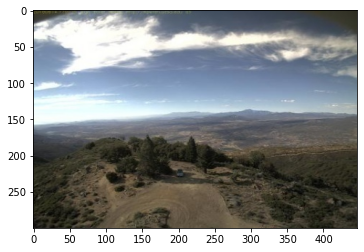

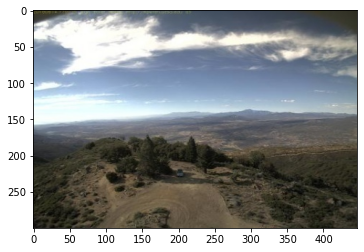

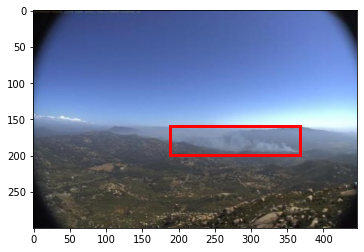

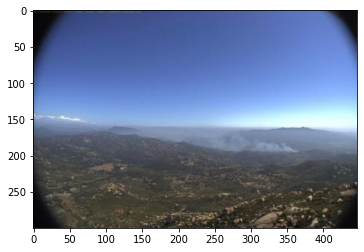

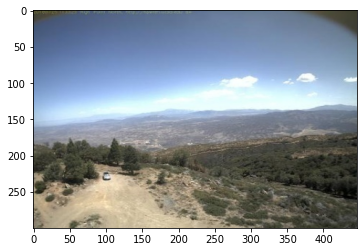

...

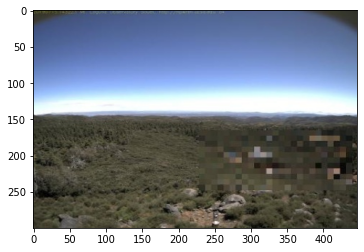

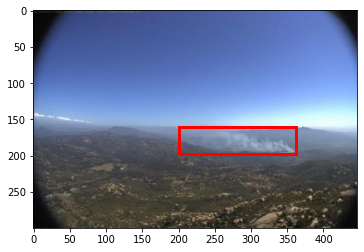

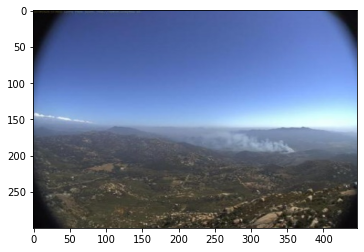

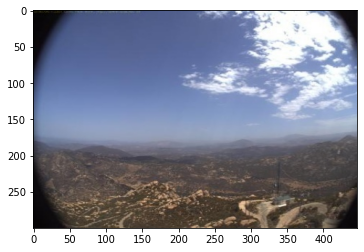

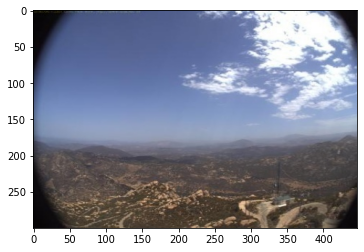

In [ ]:
for ind in range(len(train_ious)):
  print("Image ",ind+1)
  print("Actual Annotation...")
  show_corner_bb(train_imgs[ind], train_actual[ind])
  print("Predicted Annotation...")
  show_corner_bb(train_imgs[ind], train_pred[ind])
  print("Resulting IOU:", train_ious[ind])